**Getting Started**

In [ ]:
import torch
from torch import nn
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
torch.manual_seed(0)

**Display Function**

In [ ]:
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):

    image_tensor = (image_tensor + 1) / 2
    image_shifted = image_tensor
    image_unflat = image_shifted.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[: num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

**Function for Managing Dataset**

In [ ]:
import glob
import random
import os
from torch.utils.data import Dataset
from PIL import Image

class ImageDataset(Dataset):

    def __init__(self, root, transform=None, mode='train'):

        self.transform = transform
        self.files_A = sorted(glob.glob(os.path.join(root, "%sA" % mode) + "/*.*"))
        self.files_B = sorted(glob.glob(os.path.join(root, "%sB" % mode) + "/*.*"))

        if len(self.files_A) > len(self.files_B):
            self.files_A, self.files_B = self.files_B, self.files_A

        self.new_perm()
        assert len(self.files_A) > 0, "Make sure that horse2zebra files are downloaded"

    def new_perm(self):

        self.randperm = torch.randperm(len(self.files_B))[: len(self.files_A)]
    
    def __getitem__(self, index):

        item_A = self.transform(Image.open(self.files_A[index % len(self.files_A)]))
        item_B = self.transform(Image.open(self.files_B[self.randperm[index]]))
        if item_A.shape[0] != 3:
            item_A = item_A.repeat(3, 1, 1)

        if item_B.shape[0] != 3:
            item_B = item_B.repeat(3, 1, 1)
            
        if index == len(self) - 1:
            self.new_perm()

        # Normalization
        return (item_A - 0.5) * 2, (item_B - 0.5) * 2
        
    def __len__(self):

        return min(len(self.files_A), len(self.files_B))

In [ ]:
x = torch.Tensor([1, 2, 3])
print(x)
print(x.repeat(4, 2, 2))
print(x.repeat(4, 2, 2).shape)

tensor([1., 2., 3.])
tensor([[[1., 2., 3., 1., 2., 3.],
         [1., 2., 3., 1., 2., 3.]],

        [[1., 2., 3., 1., 2., 3.],
         [1., 2., 3., 1., 2., 3.]],

        [[1., 2., 3., 1., 2., 3.],
         [1., 2., 3., 1., 2., 3.]],

        [[1., 2., 3., 1., 2., 3.],
         [1., 2., 3., 1., 2., 3.]]])
torch.Size([4, 2, 6])


**Residual Block**

In [ ]:
class ResidualBlock(nn.Module):
    '''
    ResidualBlock Class:
    Performs two convolutions and an instance normalization, the input is added
    to this output to form the residual block output.
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def __init__(self, input_channels):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(input_channels, input_channels, kernel_size=3, padding=1, padding_mode='reflect')
        self.conv2 = nn.Conv2d(input_channels, input_channels, kernel_size=3, padding=1, padding_mode='reflect')
        self.instancenorm = nn.InstanceNorm2d(input_channels)
        self.activation = nn.ReLU()

    def forward(self, x):
        '''
        Function for completing a forward pass of ResidualBlock: 
        Given an image tensor, completes a residual block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        original_x = x.clone()
        x = self.conv1(x)
        x = self.instancenorm(x)
        x = self.activation(x)
        x = self.conv2(x)
        x = self.instancenorm(x)
        return original_x + x

**Contracting and Expanding Blocks**

In [ ]:
class ContractingBlock(nn.Module):

    def __init__(self, input_channels, use_bn=True, kernel_size=3, activation='relu'):

        super(ContractingBlock, self).__init__()
        self.conv1 = nn.Conv2d(input_channels, input_channels * 2, kernel_size=kernel_size, padding=1, stride=2, padding_mode='reflect')
        self.activation = nn.ReLU() if activation == 'relu' else nn.LeakyReLU(0.2)
        if use_bn:
            self.instancenorm = nn.InstanceNorm2d(input_channels * 2)
        self.use_bn = use_bn

    def forward(self, x):

        x = self.conv1(x)
        if self.use_bn:
            x = self.instancenorm(x)
        x = self.activation(x)
        return x

class ExpandingBlock(nn.Module):

    def __init__(self, input_channels, use_bn=True):

        super(ExpandingBlock, self).__init__()
        self.conv1 = nn.ConvTranspose2d(input_channels, input_channels // 2, kernel_size=3, stride=2, padding=1, output_padding=1)
        
        if use_bn:
            self.instancenorm = nn.InstanceNorm2d(input_channels // 2)
        self.use_bn = use_bn
        self.activation = nn.ReLU()

    def forward(self, x):

        x = self.conv1(x)
        if self.use_bn:
            x = self.instancenorm(x)
        x = self.activation(x)
        return x

class FeatureMapBlock(nn.Module):

    def __init__(self, input_channels, output_channels):
        super(FeatureMapBlock, self).__init__()
        self.conv = nn.Conv2d(input_channels, output_channels, kernel_size=7, padding=3, padding_mode='reflect')

    def forward(self, x):
        x = self.conv(x)
        return x



**CycleGAN Generator**

In [ ]:
class Generator(nn.Module):

    def __init__(self, input_channels, output_channels, hidden_channels=64):

        super(Generator, self).__init__()
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContractingBlock(hidden_channels)
        self.contract2 = ContractingBlock(hidden_channels * 2)
        res_mult = 4
        self.res0 = ResidualBlock(hidden_channels * res_mult)
        self.res1 = ResidualBlock(hidden_channels * res_mult)
        self.res2 = ResidualBlock(hidden_channels * res_mult)
        self.res3 = ResidualBlock(hidden_channels * res_mult)
        self.res4 = ResidualBlock(hidden_channels * res_mult)
        self.res5 = ResidualBlock(hidden_channels * res_mult)
        self.res6 = ResidualBlock(hidden_channels * res_mult)
        self.res7 = ResidualBlock(hidden_channels * res_mult)
        self.res8 = ResidualBlock(hidden_channels * res_mult)
        self.expand2 = ExpandingBlock(hidden_channels * 4)
        self.expand3 = ExpandingBlock(hidden_channels * 2)
        self.downfeature = FeatureMapBlock(hidden_channels, output_channels)
        self.tanh = torch.nn.Tanh()

    def forward(self, x):

        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.res0(x2)
        x4 = self.res1(x3)
        x5 = self.res2(x4)
        x6 = self.res3(x5)
        x7 = self.res4(x6)
        x8 = self.res5(x7)
        x9 = self.res6(x8)
        x10 = self.res7(x9)
        x11 = self.res8(x10)
        x12 = self.expand2(x11)
        x13 = self.expand3(x12)
        xn = self.downfeature(x13)
        return self.tanh(xn)

**Patch GAN Discriminator**

In [ ]:
class Discriminator(nn.Module):

    def __init__(self, input_channels, hidden_channels=64):

        super(Discriminator, self).__init__()
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContractingBlock(hidden_channels, use_bn=False, kernel_size=4, activation='lrelu')
        self.contract2 = ContractingBlock(hidden_channels * 2, kernel_size=4, activation='lrelu')
        self.contract3 = ContractingBlock(hidden_channels * 4, kernel_size=4, activation='lrelu')
        self.final = nn.Conv2d(hidden_channels * 8, 1, kernel_size=1)
        
    def forward(self, x):

        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.contract3(x2)
        xn = self.final(x3)
        return xn

**Training Preparation**

In [ ]:
import torch.nn.functional as F

adv_criterion = nn.MSELoss()
recon_criterion = nn.L1Loss()

n_epochs = 20
dim_A = 3
dim_B = 3
display_step = 300
batch_size = 1
lr = 0.0002
load_shape = 286
target_shape = 256
device = 'cuda'

In [ ]:
transform = transforms.Compose([
                                transforms.Resize(load_shape),
                                transforms.RandomCrop(target_shape),
                                transforms.RandomHorizontalFlip(),
                                transforms.ToTensor()
])

import torchvision
dataset = ImageDataset('/content/drive/MyDrive/horse2zebra', transform=transform)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#!unzip /content/drive/MyDrive/hor2zeb/horse2zebra.zip -d /content/drive/MyDrive/hor2zeb/horse2zebra

In [ ]:
gen_AB = Generator(dim_A, dim_B).to(device)
gen_BA = Generator(dim_B, dim_A).to(device)
# Using the same optimizer for both the generators
gen_opt = torch.optim.Adam(list(gen_AB.parameters()) + list(gen_BA.parameters()), lr=lr, betas=(0.5, 0.999))
disc_A = Discriminator(dim_A).to(device)
disc_A_opt = torch.optim.Adam(disc_A.parameters(), lr=lr, betas=(0.5, 0.999))
disc_B = Discriminator(dim_B).to(device)
disc_B_opt = torch.optim.Adam(disc_B.parameters(), lr=lr, betas=(0.5, 0.999))

def weights_init(m):

    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)

    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)

gen_AB = gen_AB.apply(weights_init)
gen_BA = gen_BA.apply(weights_init)
disc_A = disc_A.apply(weights_init)
disc_B = disc_B.apply(weights_init)

**Discriminator Loss**

In [ ]:
def get_disc_loss(real_X, fake_X, disc_X, adv_criterion):

    '''
    Return the loss of the discriminator given inputs.
    Parameters:
        real_X: the real images from pile X
        fake_X: the generated images of class X
        disc_X: the discriminator for class X; takes images and returns real/fake class X
            prediction matrices
        adv_criterion: the adversarial loss function; takes the discriminator 
            predictions and the target labels and returns a adversarial 
            loss (which you aim to minimize)
    '''
    disc_real_hat = disc_X(real_X.detach())
    disc_real_loss = adv_criterion(disc_real_hat, torch.ones_like(disc_real_hat))
    disc_fake_hat = disc_X(fake_X.detach())
    disc_fake_loss = adv_criterion(disc_fake_hat, torch.zeros_like(disc_fake_hat))
    disc_loss = (disc_real_loss + disc_fake_loss) / 2

    return disc_loss

In [ ]:
# UNIT TEST
test_disc_X = lambda x: x * 97
test_real_X = torch.tensor(83.)
test_fake_X = torch.tensor(89.)
test_adv_criterion = lambda x, y: x * 79 + y * 73
assert torch.abs((get_disc_loss(test_real_X, test_fake_X, test_disc_X, test_adv_criterion)) - 659054.5000) < 1e-6
test_disc_X = lambda x: x.mean(0, keepdim=True)
test_adv_criterion = torch.nn.BCEWithLogitsLoss()
test_input = torch.ones(20, 10)
# If this runs, it's a pass - checks that the shapes are treated correctly
get_disc_loss(test_input, test_input, test_disc_X, test_adv_criterion)
print("Success!")

Success!


**Generator Loss**

In [ ]:
def get_gen_adversarial_loss(real_X, disc_Y, gen_XY, adv_criterion):

    '''
    Return the adversarial loss of the generator given inputs
    (and the generated images for testing purposes).
    Parameters:
        real_X: the real images from pile X
        disc_Y: the discriminator for class Y; takes images and returns real/fake class Y
            prediction matrices
        gen_XY: the generator for class X to Y; takes images and returns the images 
            transformed to class Y
        adv_criterion: the adversarial loss function; takes the discriminator 
                  predictions and the target labels and returns a adversarial 
                  loss (which you aim to minimize)
    '''
    fake_Y = gen_XY(real_X)
    disc_fake_hat = disc_Y(fake_Y)
    adversarial_loss = adv_criterion(disc_fake_hat, torch.ones_like(disc_fake_hat))

    return adversarial_loss, fake_Y

In [ ]:
# UNIT TEST
test_disc_Y = lambda x: x * 97
test_real_X = torch.tensor(83.)
test_gen_XY = lambda x: x * 89
test_adv_criterion = lambda x, y: x * 79 + y * 73
test_res = get_gen_adversarial_loss(test_real_X, test_disc_Y, test_gen_XY, test_adv_criterion)
assert torch.abs(test_res[0] - 56606652) < 1e-6
assert torch.abs(test_res[1] - 7387) < 1e-6
print("Success!")

Success!


**Identity Loss**

In [ ]:
def get_identity_loss(real_X, gen_YX, identity_criterion):

    '''
    Return the identity loss of the generator given inputs
    (and the generated images for testing purposes).
    Parameters:
        real_X: the real images from pile X
        gen_YX: the generator for class Y to X; takes images and returns the images 
            transformed to class X
        identity_criterion: the identity loss function; takes the real images from X and
                        those images put through a Y->X generator and returns the identity 
                        loss (which you aim to minimize)
    '''
    identity_X = gen_YX(real_X)
    identity_loss = identity_criterion(identity_X, real_X)

    return identity_loss, identity_X

In [ ]:
# UNIT TEST
test_real_X = torch.tensor(83.)
test_gen_YX = lambda x: x * 89
test_identity_criterion = lambda x, y: (x + y) * 73
test_res = get_identity_loss(test_real_X, test_gen_YX, test_identity_criterion)
assert torch.abs(test_res[0] - 545310) < 1e-6
assert torch.abs(test_res[1] - 7387) < 1e-6
print("Success!")

Success!


**Cycle Consistency Loss**

In [ ]:
def get_cycle_consistency_loss(real_X, fake_Y, gen_YX, cycle_criterion):

    '''
    Return the cycle consistency loss of the generator given inputs
    (and the generated images for testing purposes).
    Parameters:
        real_X: the real images from pile X
        fake_Y: the generated images of class Y
        gen_YX: the generator for class Y to X; takes images and returns the images 
            transformed to class X
        cycle_criterion: the cycle consistency loss function; takes the real images from X and
                        those images put through a X->Y generator and then Y->X generator
                        and returns the cycle consistency loss (which you aim to minimize)
    '''
    cycle_X = gen_YX(fake_Y)
    cycle_loss = cycle_criterion(cycle_X, real_X)

    return cycle_loss, cycle_X

In [ ]:
# UNIT TEST
test_real_X = torch.tensor(83.)
test_fake_Y = torch.tensor(97.)
test_gen_YX = lambda x: x * 89
test_cycle_criterion = lambda x, y: (x + y) * 73
test_res = get_cycle_consistency_loss(test_real_X, test_fake_Y, test_gen_YX, test_cycle_criterion)
assert torch.abs(test_res[1] - 8633) < 1e-6
assert torch.abs(test_res[0] - 636268) < 1e-6
print("Success!")

Success!


**Generator Loss (Total)**

In [ ]:
# A - Horse, B - Zebra
def get_gen_loss(real_A, real_B, gen_AB, gen_BA, disc_A, disc_B, adv_criterion, identity_criterion, cycle_criterion, lambda_identity=0.1, 
                 lambda_cycle=10):
    '''
    Return the loss of the generator given inputs.
    Parameters:
        real_A: the real images from pile A
        real_B: the real images from pile B
        gen_AB: the generator for class A to B; takes images and returns the images 
            transformed to class B
        gen_BA: the generator for class B to A; takes images and returns the images 
            transformed to class A
        disc_A: the discriminator for class A; takes images and returns real/fake class A
            prediction matrices
        disc_B: the discriminator for class B; takes images and returns real/fake class B
            prediction matrices
        adv_criterion: the adversarial loss function; takes the discriminator 
            predictions and the true labels and returns a adversarial 
            loss (which you aim to minimize)
        identity_criterion: the reconstruction loss function used for identity loss
            and cycle consistency loss; takes two sets of images and returns
            their pixel differences (which you aim to minimize)
        cycle_criterion: the cycle consistency loss function; takes the real images from X and
            those images put through a X->Y generator and then Y->X generator
            and returns the cycle consistency loss (which you aim to minimize).
            Note that in practice, cycle_criterion == identity_criterion == L1 loss
        lambda_identity: the weight of the identity loss
        lambda_cycle: the weight of the cycle-consistency loss
    '''
    # Adversarial loss
    adv_loss_AB, fake_B = get_gen_adversarial_loss(real_A, disc_B, gen_AB, adv_criterion)
    adv_loss_BA, fake_A = get_gen_adversarial_loss(real_B, disc_A, gen_BA, adv_criterion)
    adv_loss = adv_loss_AB + adv_loss_BA
    
    # Identity Loss
    identity_loss_A, identity_A = get_identity_loss(real_A, gen_BA, identity_criterion)
    identity_loss_B, identity_B = get_identity_loss(real_B, gen_AB, identity_criterion)
    identity_loss = identity_loss_A + identity_loss_B

    # Cycle-Consistency Loss
    cycle_loss_BA, cycle_A = get_cycle_consistency_loss(real_A, fake_B, gen_BA, cycle_criterion)
    cycle_loss_AB, cycle_B = get_cycle_consistency_loss(real_B, fake_A, gen_AB, cycle_criterion)
    gen_cycle_loss = cycle_loss_AB + cycle_loss_BA

    # Total Generator loss 
    gen_loss = adv_loss + lambda_cycle * gen_cycle_loss + lambda_identity * identity_loss

    return gen_loss, fake_A, fake_B

In [ ]:
# UNIT TEST
test_real_A = torch.tensor(97)
test_real_B = torch.tensor(89)
test_gen_AB = lambda x: x * 83
test_gen_BA = lambda x: x * 79
test_disc_A = lambda x: x * 47
test_disc_B = lambda x: x * 43
test_adv_criterion = lambda x, y: x * 73 + y * 71
test_recon_criterion = lambda x, y: (x + y) * 61
test_lambda_identity = 59
test_lambda_cycle = 53
test_res = get_gen_loss(
    test_real_A, 
    test_real_B, 
    test_gen_AB, 
    test_gen_BA, 
    test_disc_A,
    test_disc_B,
    test_adv_criterion, 
    test_recon_criterion, 
    test_recon_criterion, 
    test_lambda_identity, 
    test_lambda_cycle)
assert test_res[0].item() == 4047804560
assert test_res[1].item() == 7031
assert test_res[2].item() == 8051
print("Success!")

Success!


**CycleGAN Training**

Epoch 0: Step 0: Generator (U-Net) loss: 0.04742988268534343, Discriminator loss: 0.001851120392481486


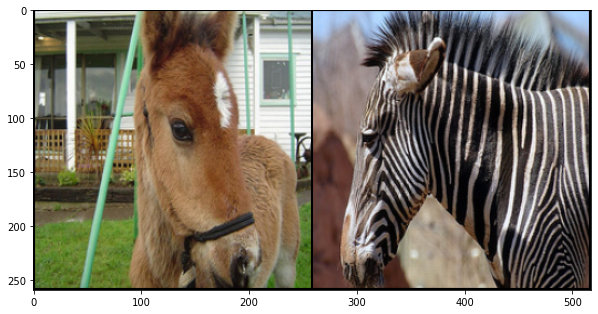

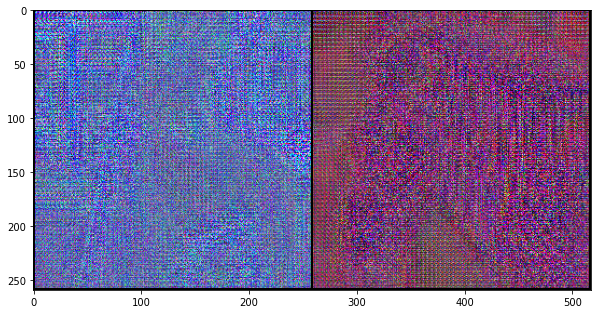

Epoch 0: Step 300: Generator (U-Net) loss: 6.810490483442945, Discriminator loss: 0.24834850703676542


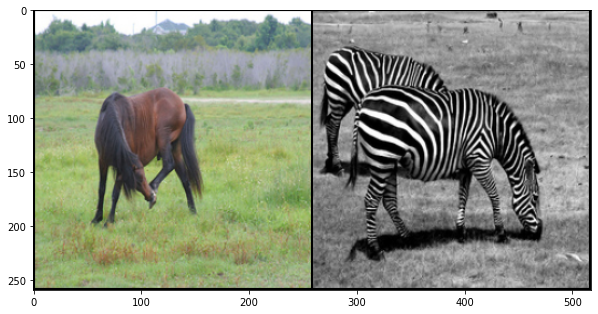

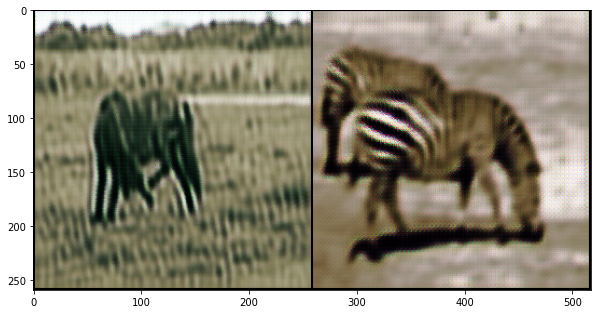

Epoch 0: Step 600: Generator (U-Net) loss: 5.892369205951689, Discriminator loss: 0.23737793013453495


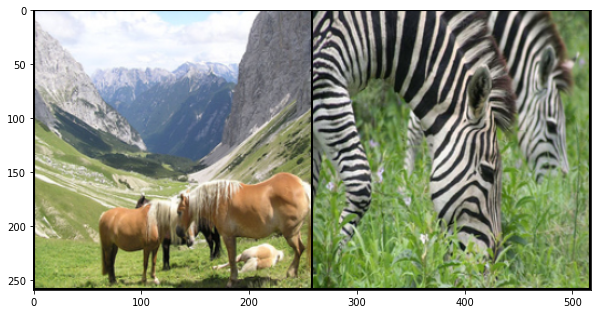

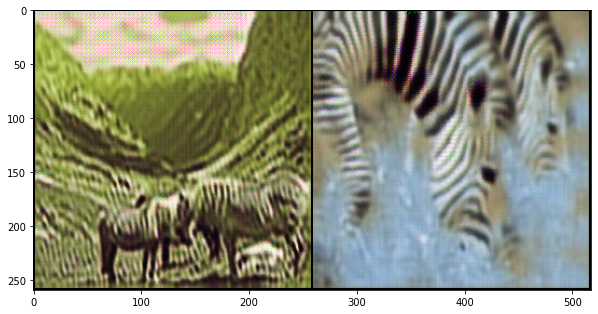

Epoch 0: Step 900: Generator (U-Net) loss: 5.574128181139628, Discriminator loss: 0.24090366169810298


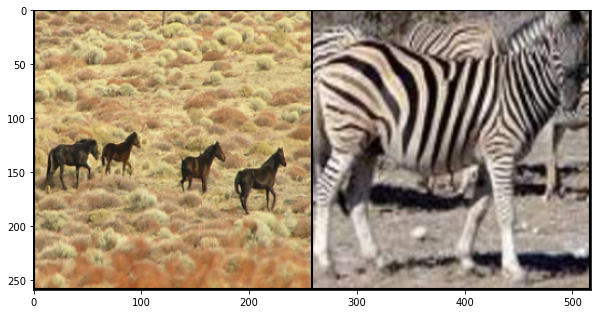

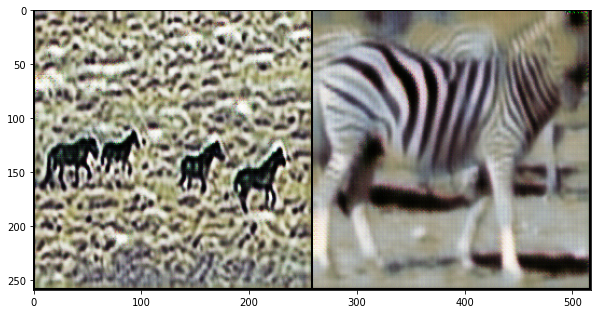

Epoch 1: Step 1200: Generator (U-Net) loss: 5.298316911061604, Discriminator loss: 0.23603370547294625


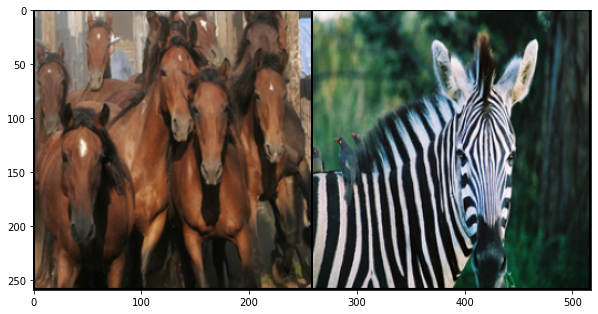

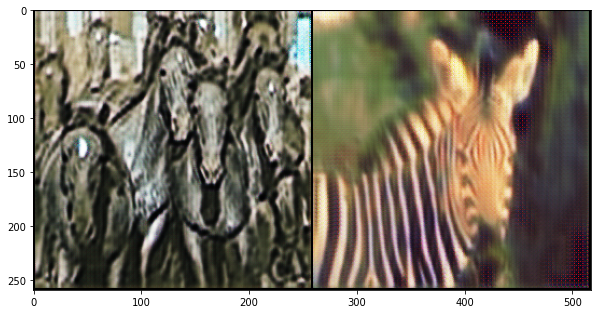

Epoch 1: Step 1500: Generator (U-Net) loss: 5.21939536809921, Discriminator loss: 0.23420422054827206


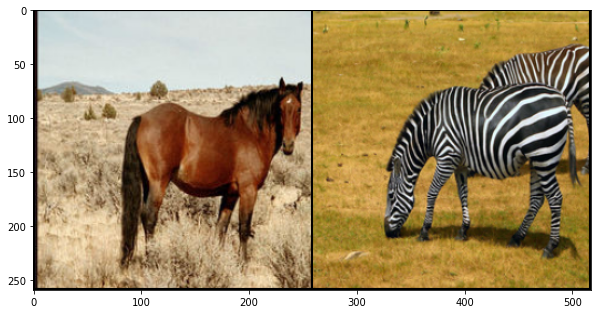

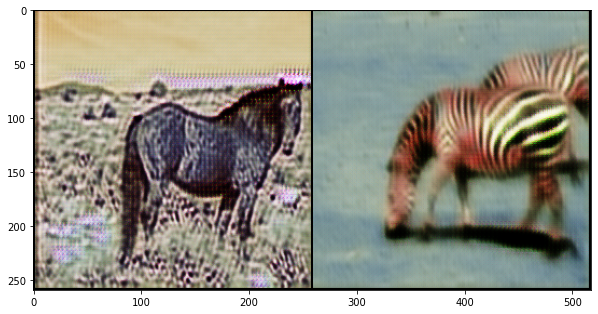

Epoch 1: Step 1800: Generator (U-Net) loss: 4.9838136871655765, Discriminator loss: 0.23751691035926345


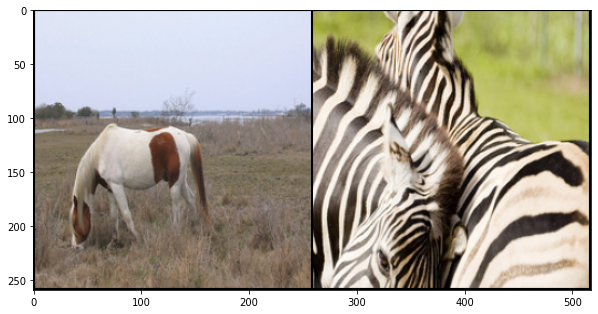

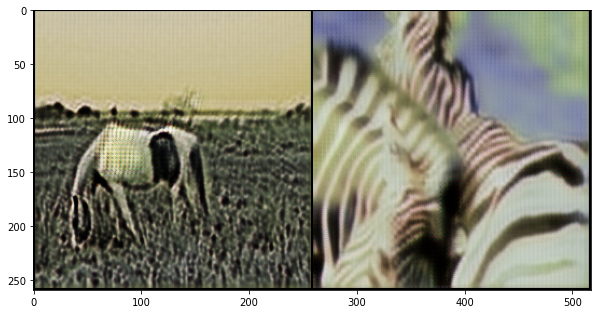

Epoch 1: Step 2100: Generator (U-Net) loss: 4.895299318631489, Discriminator loss: 0.23283615067601204


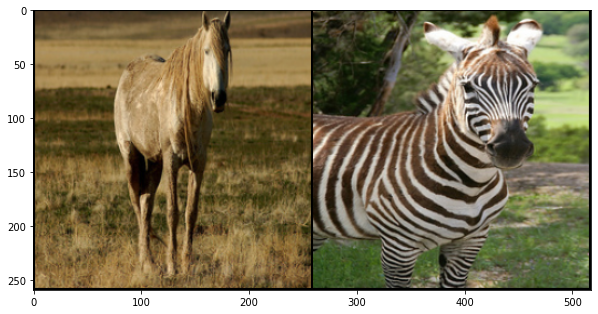

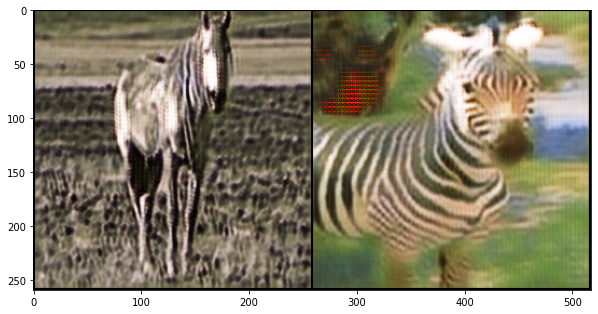

Epoch 2: Step 2400: Generator (U-Net) loss: 4.915186648368839, Discriminator loss: 0.23495887209971736


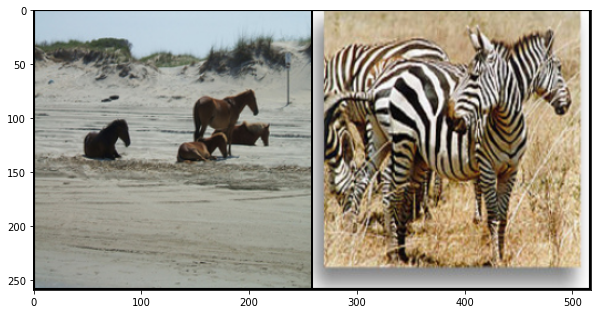

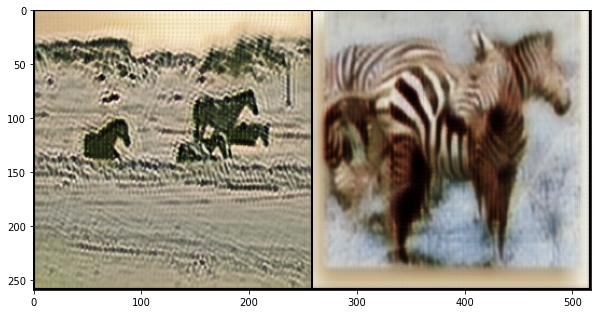

Epoch 2: Step 2700: Generator (U-Net) loss: 4.7272656130790685, Discriminator loss: 0.23808755656083422


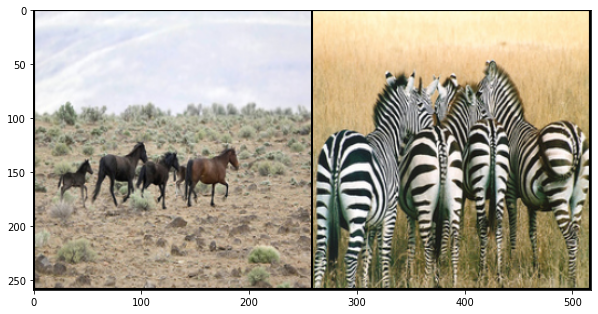

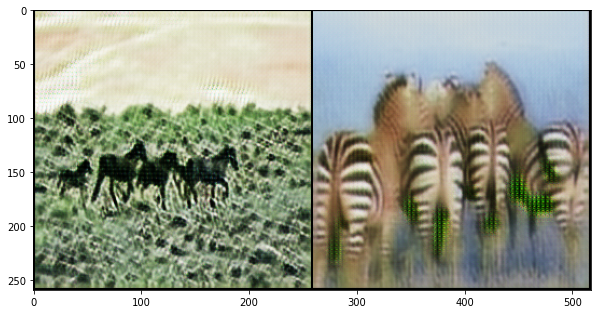

Epoch 2: Step 3000: Generator (U-Net) loss: 4.633576859633127, Discriminator loss: 0.22935289318362864


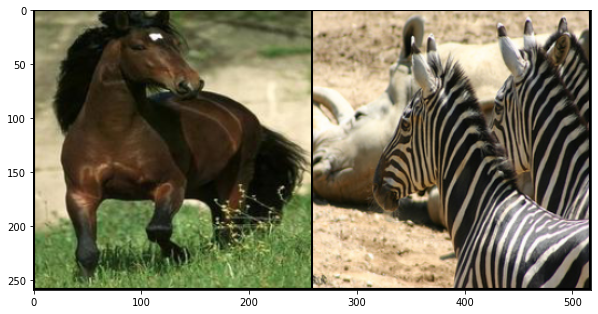

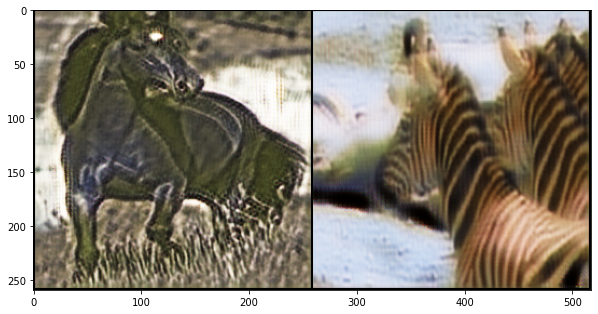

Epoch 3: Step 3300: Generator (U-Net) loss: 4.532468903064728, Discriminator loss: 0.23253982322911412


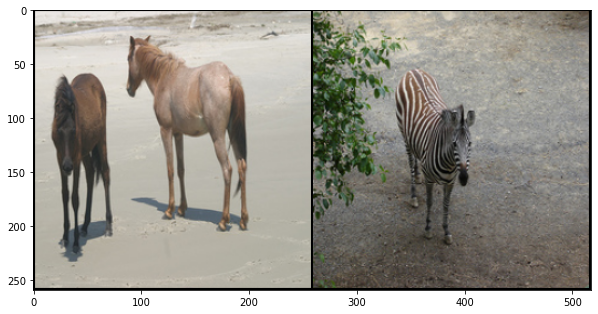

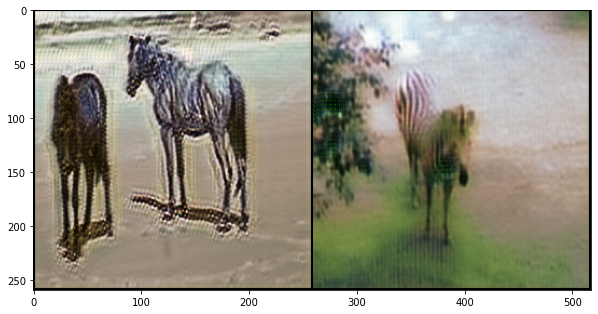

Epoch 3: Step 3600: Generator (U-Net) loss: 4.60281849225362, Discriminator loss: 0.2291304351141056


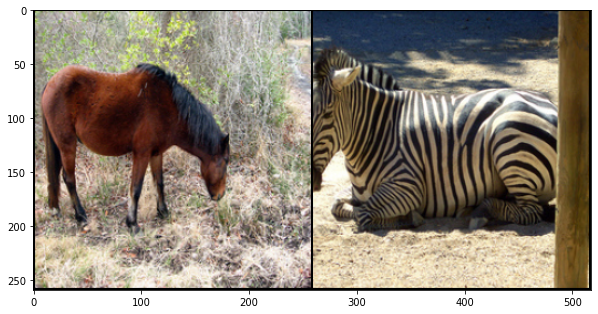

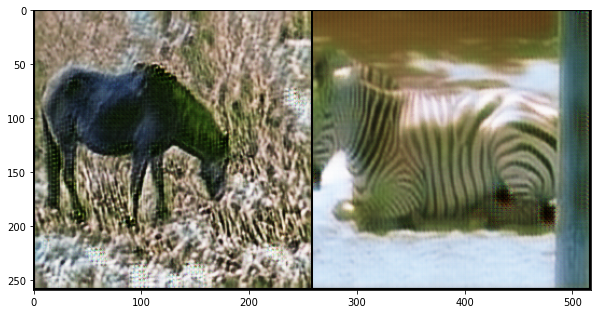

Epoch 3: Step 3900: Generator (U-Net) loss: 4.5280708813667285, Discriminator loss: 0.2310345935821533


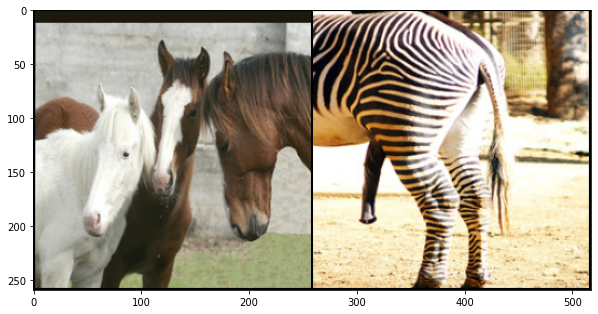

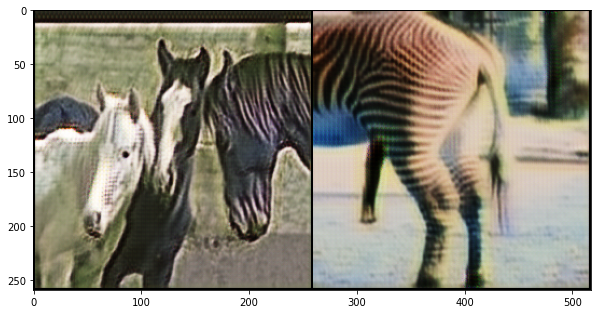

Epoch 3: Step 4200: Generator (U-Net) loss: 4.467505858739217, Discriminator loss: 0.23022072461744142


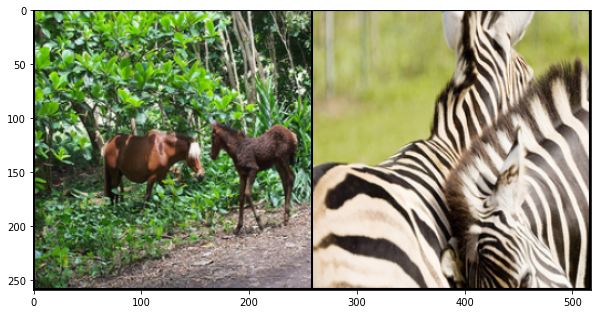

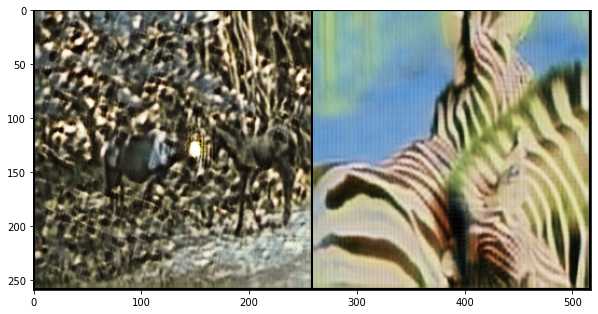

Epoch 4: Step 4500: Generator (U-Net) loss: 4.379744528134661, Discriminator loss: 0.22984516225755214


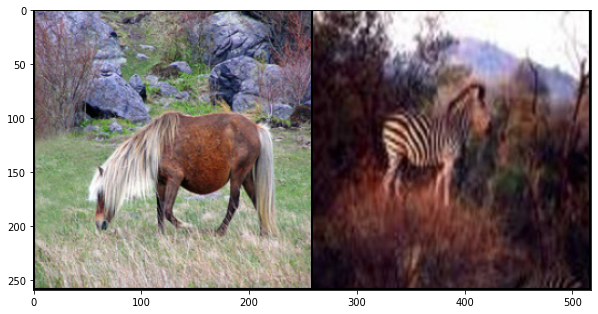

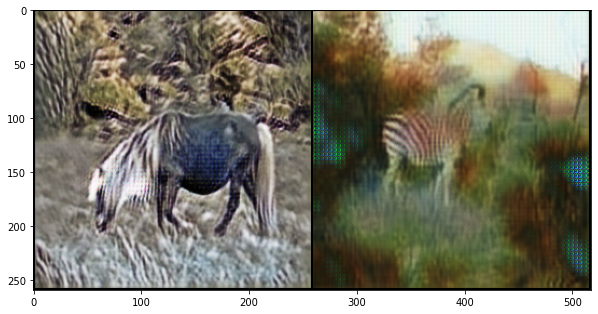

Epoch 4: Step 4800: Generator (U-Net) loss: 4.436713110605875, Discriminator loss: 0.226976860811313


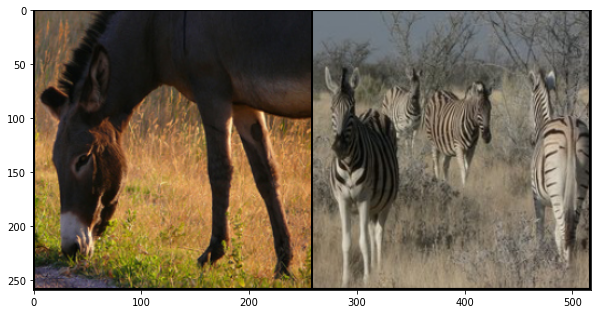

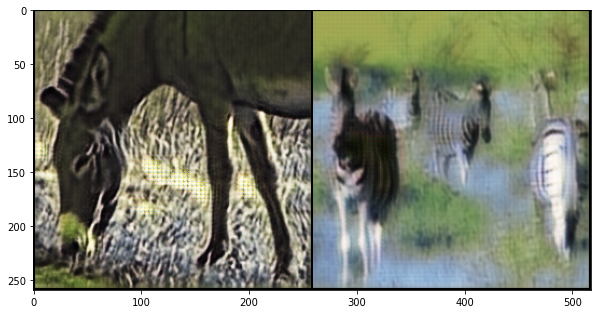

Epoch 4: Step 5100: Generator (U-Net) loss: 4.255072065989173, Discriminator loss: 0.22619841193159423


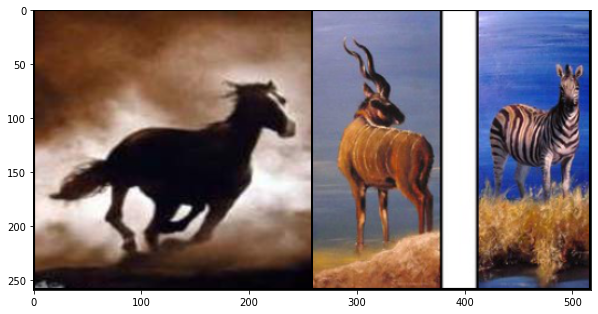

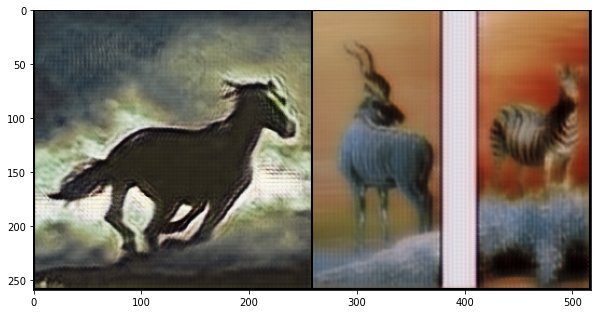

Epoch 5: Step 5400: Generator (U-Net) loss: 4.283197809060415, Discriminator loss: 0.2292500823239485


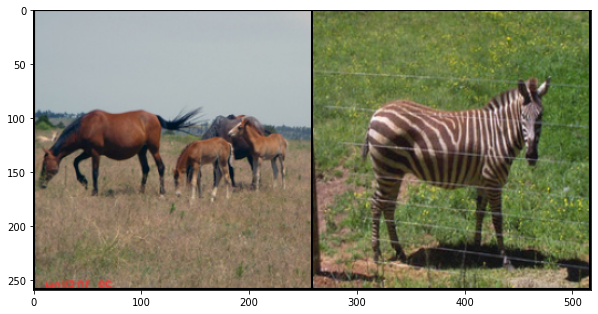

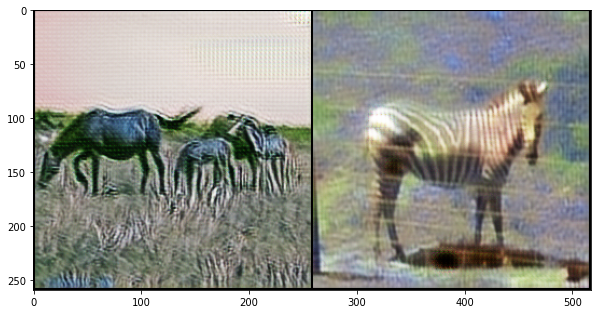

Epoch 5: Step 5700: Generator (U-Net) loss: 4.292825700441996, Discriminator loss: 0.23105025718609495


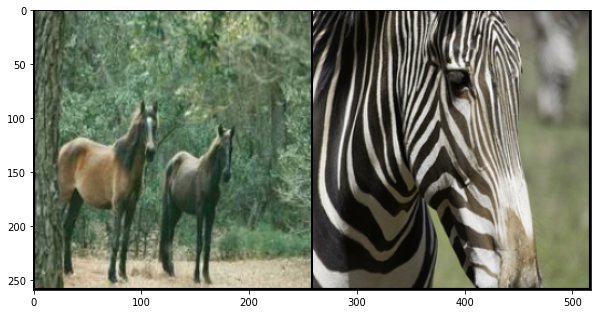

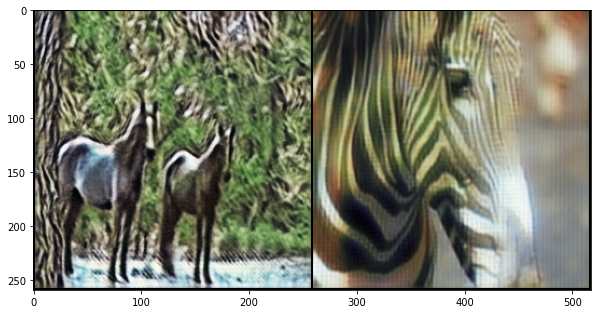

Epoch 5: Step 6000: Generator (U-Net) loss: 4.214211141268416, Discriminator loss: 0.22383246192087736


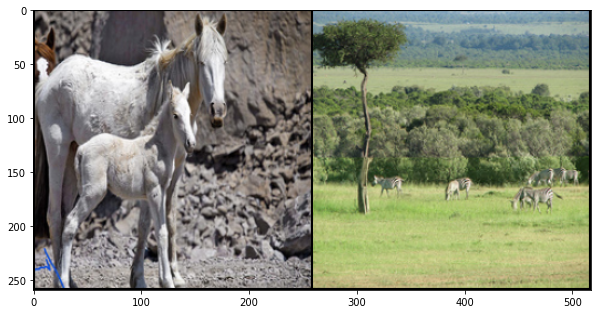

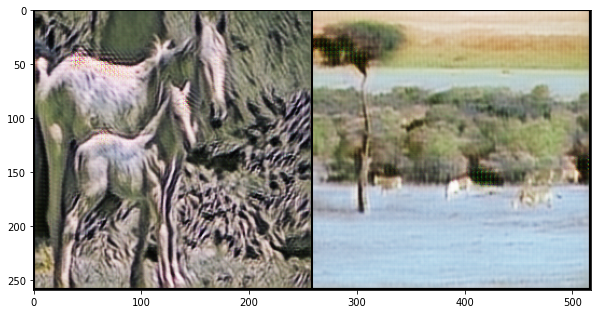

Epoch 5: Step 6300: Generator (U-Net) loss: 4.243771475156146, Discriminator loss: 0.22695782802999015


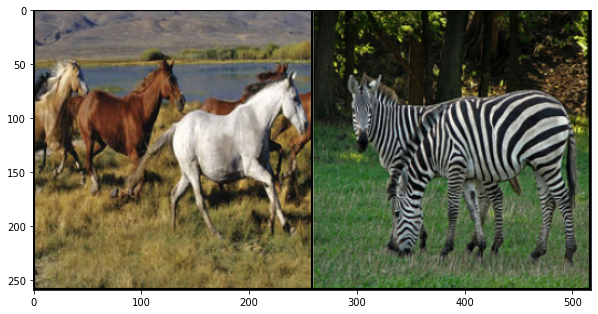

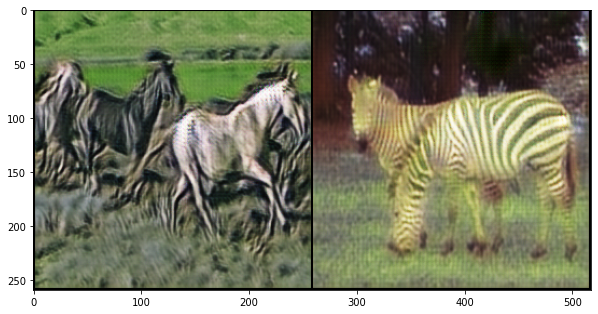

Epoch 6: Step 6600: Generator (U-Net) loss: 4.177821952501933, Discriminator loss: 0.22705211030940217


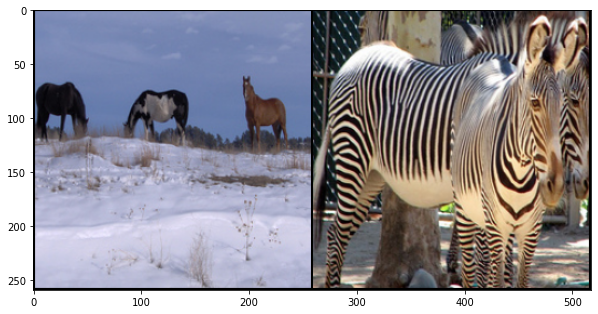

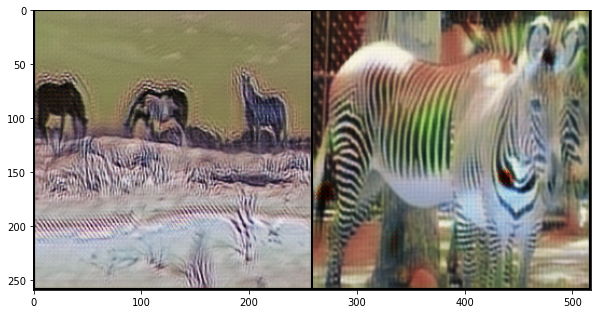

Epoch 6: Step 6900: Generator (U-Net) loss: 4.185376619497934, Discriminator loss: 0.22506117309133192


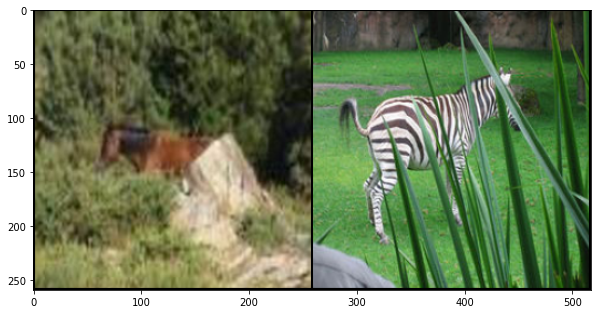

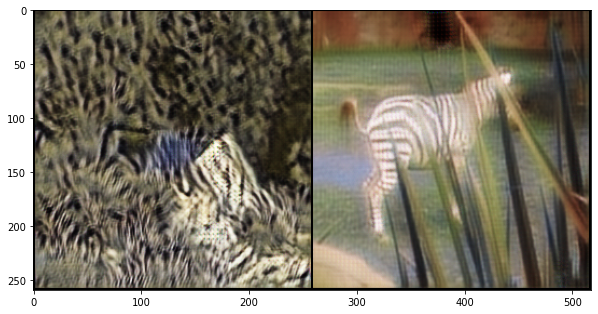

Epoch 6: Step 7200: Generator (U-Net) loss: 4.09468450387319, Discriminator loss: 0.22731642268598076


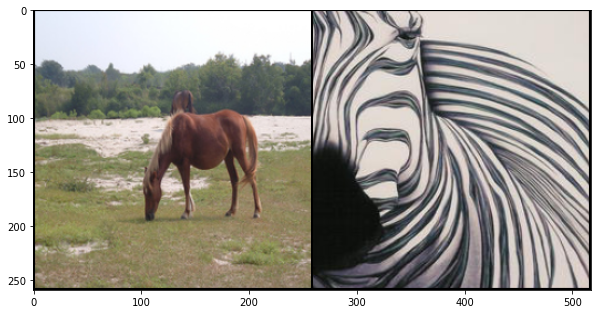

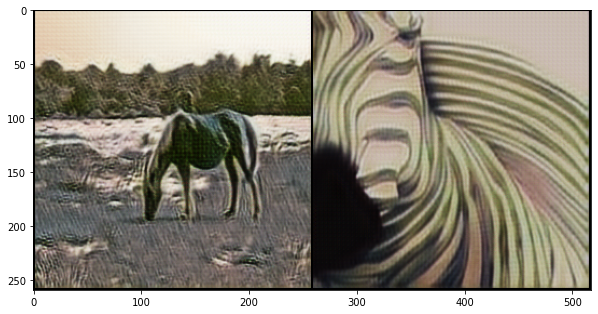

Epoch 7: Step 7500: Generator (U-Net) loss: 4.0912646993001305, Discriminator loss: 0.22318099680046233


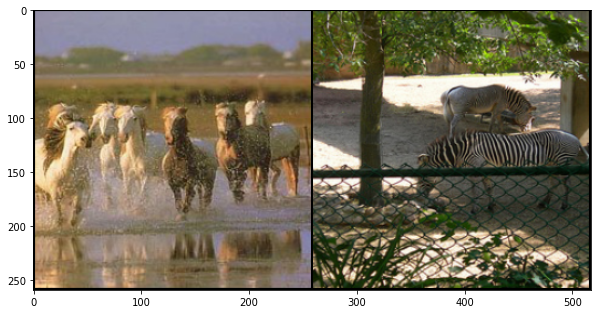

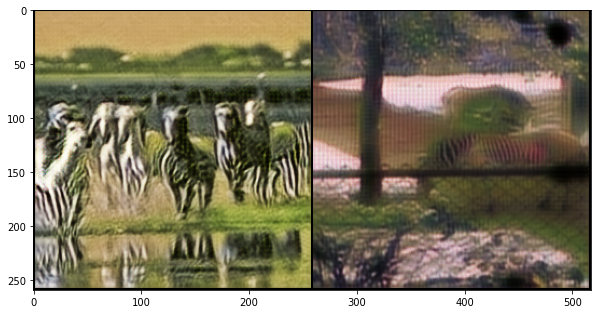

Epoch 7: Step 7800: Generator (U-Net) loss: 4.041618752479551, Discriminator loss: 0.2229646294067303


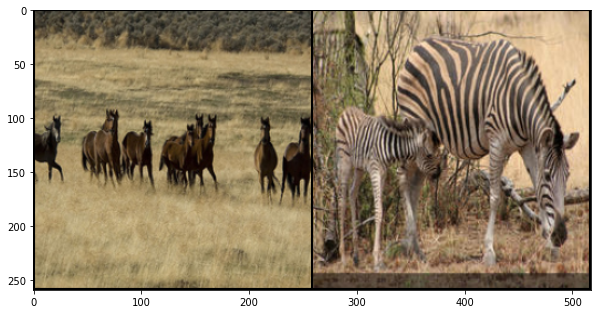

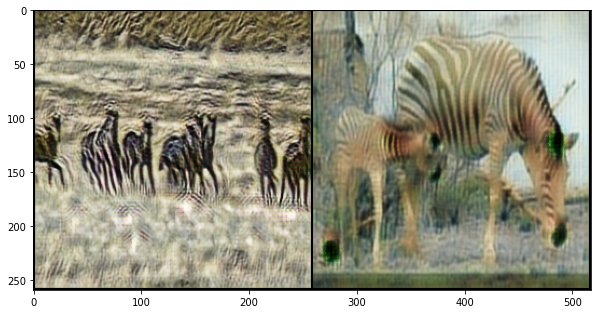

Epoch 7: Step 8100: Generator (U-Net) loss: 4.093964611689254, Discriminator loss: 0.22653058387339126


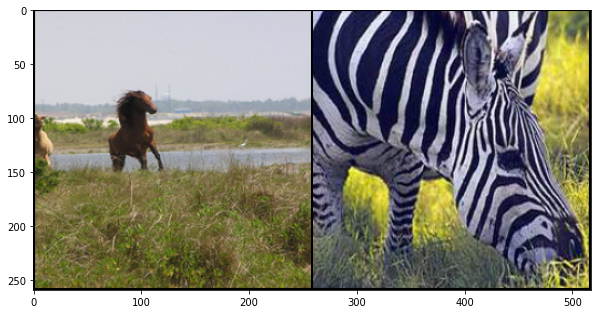

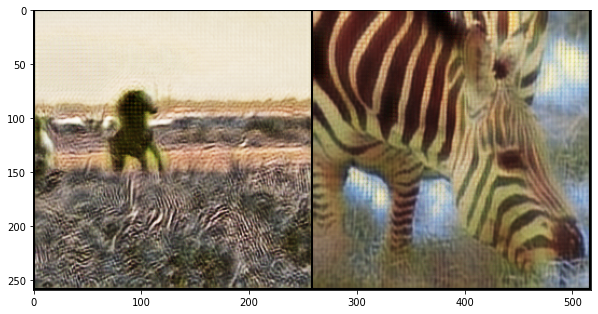

Epoch 7: Step 8400: Generator (U-Net) loss: 4.148256955146788, Discriminator loss: 0.2183076524734496


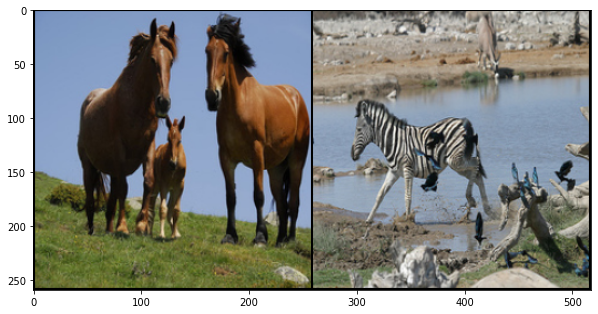

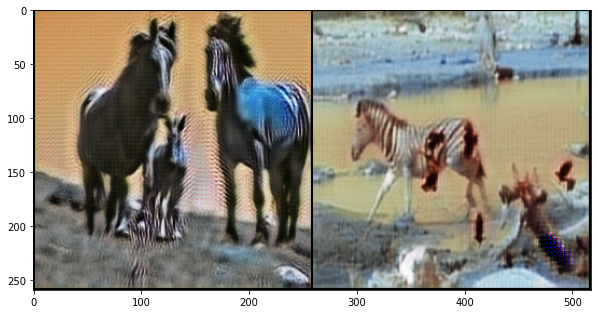

Epoch 8: Step 8700: Generator (U-Net) loss: 4.090379980405173, Discriminator loss: 0.21606369939943137


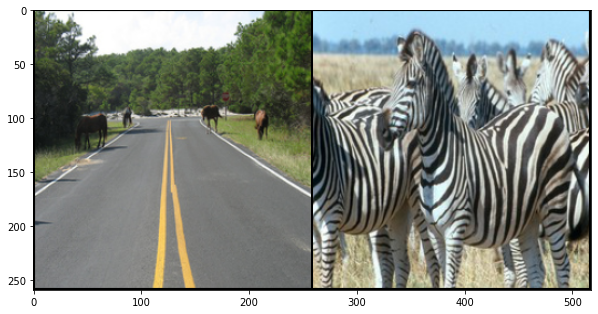

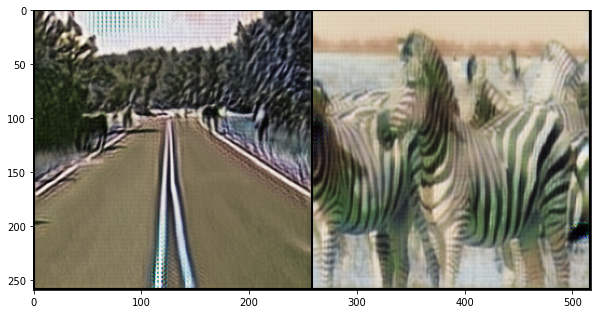

Epoch 8: Step 9000: Generator (U-Net) loss: 3.948538887500762, Discriminator loss: 0.2258868999779223


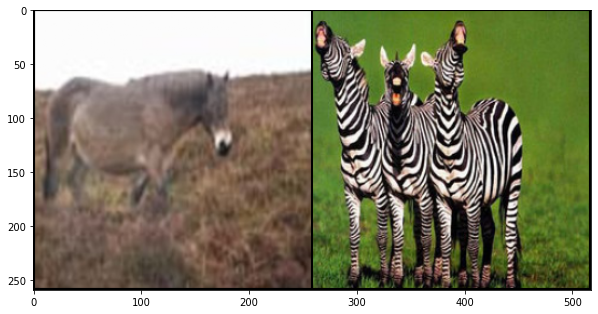

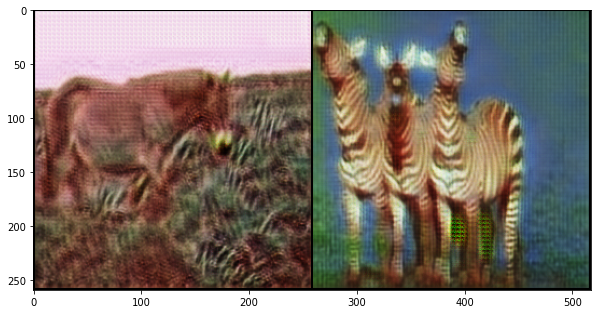

Epoch 8: Step 9300: Generator (U-Net) loss: 3.9645431772867834, Discriminator loss: 0.21565274802347018


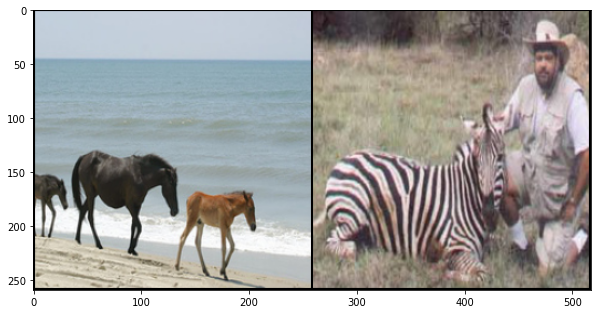

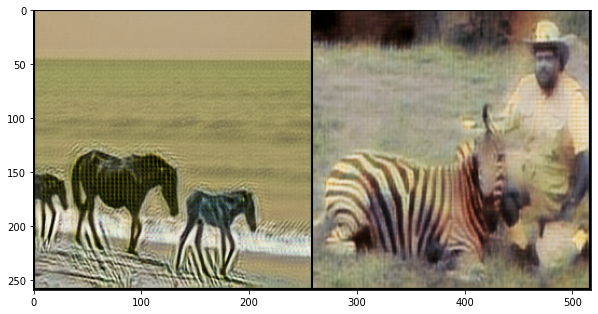

Epoch 8: Step 9600: Generator (U-Net) loss: 4.085751404762266, Discriminator loss: 0.22326524677375936


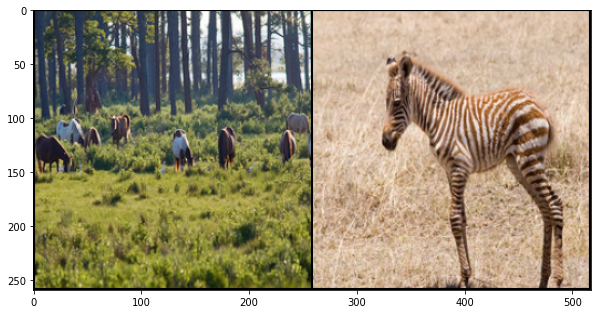

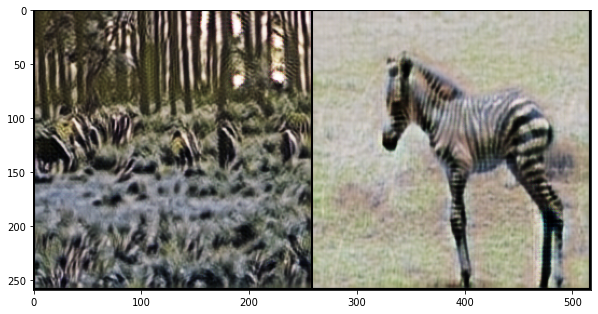

Epoch 9: Step 9900: Generator (U-Net) loss: 3.982717961470285, Discriminator loss: 0.21710204047461362


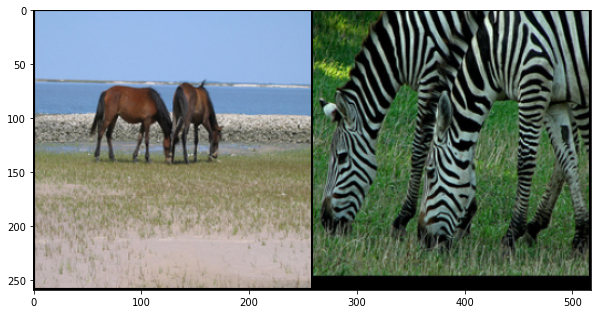

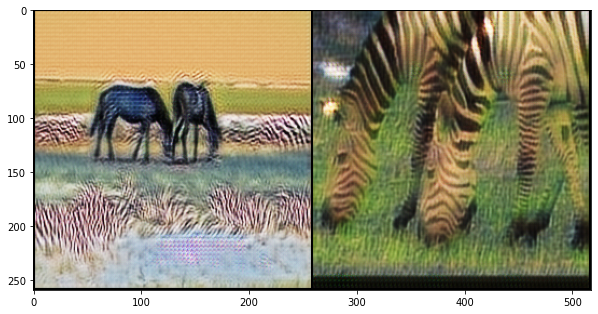

Epoch 9: Step 10200: Generator (U-Net) loss: 4.036728496551516, Discriminator loss: 0.21498701805869733


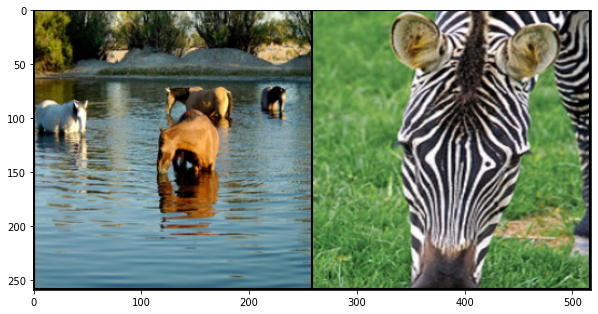

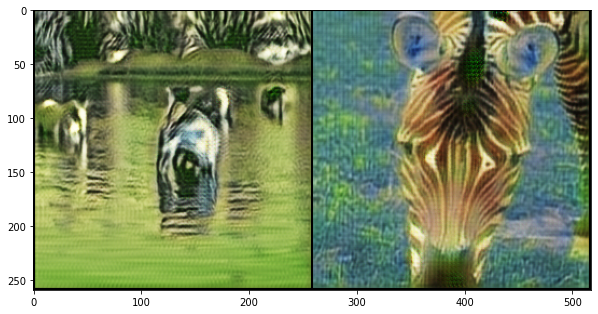

Epoch 9: Step 10500: Generator (U-Net) loss: 3.983371130625406, Discriminator loss: 0.21396455459296695


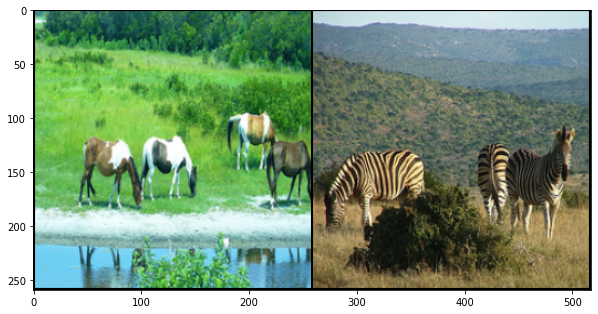

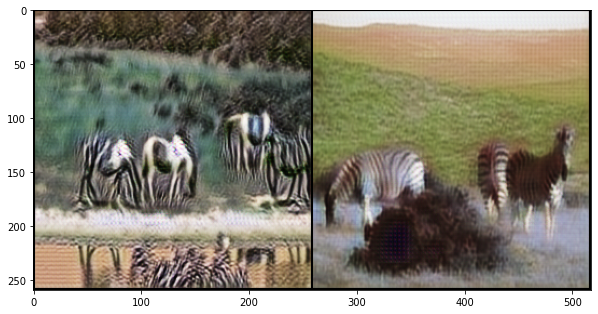

Epoch 10: Step 10800: Generator (U-Net) loss: 3.939459403355918, Discriminator loss: 0.2186410213758548


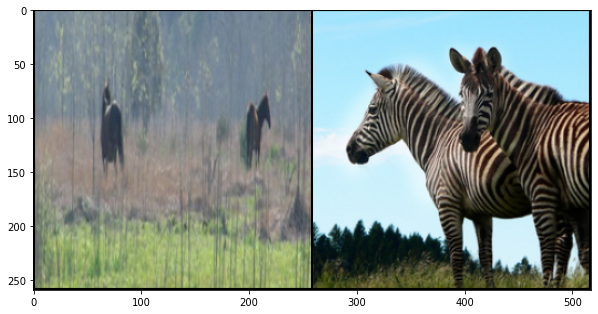

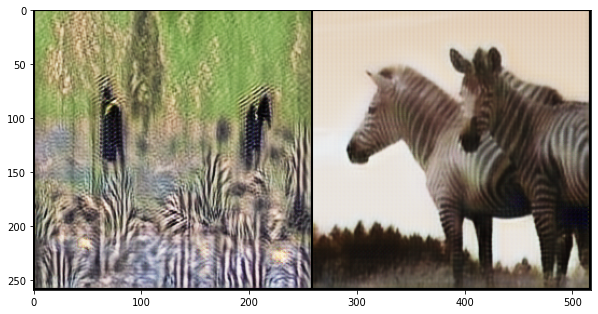

Epoch 10: Step 11100: Generator (U-Net) loss: 3.890853170553844, Discriminator loss: 0.21125345277289556


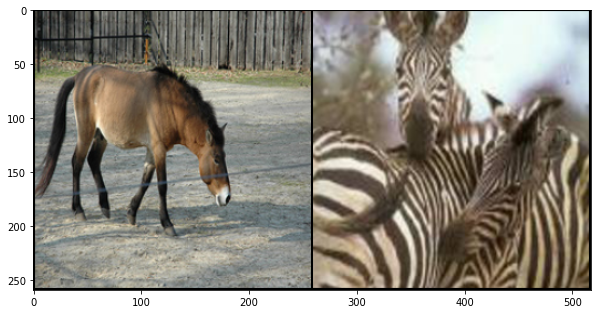

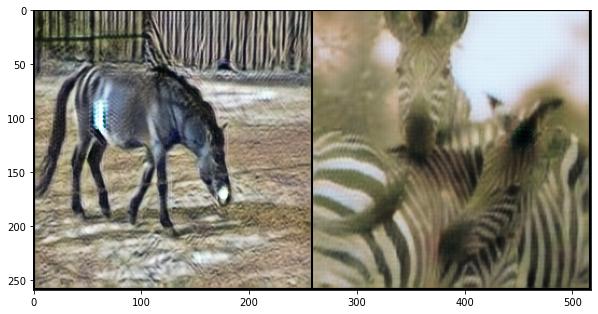

Epoch 10: Step 11400: Generator (U-Net) loss: 3.869019005298613, Discriminator loss: 0.21616808625559011


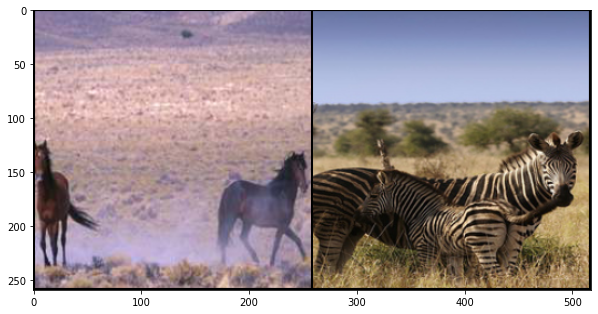

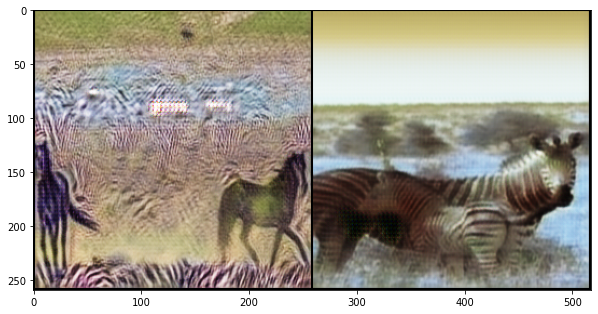

Epoch 10: Step 11700: Generator (U-Net) loss: 3.9227449536323538, Discriminator loss: 0.21225941518942523


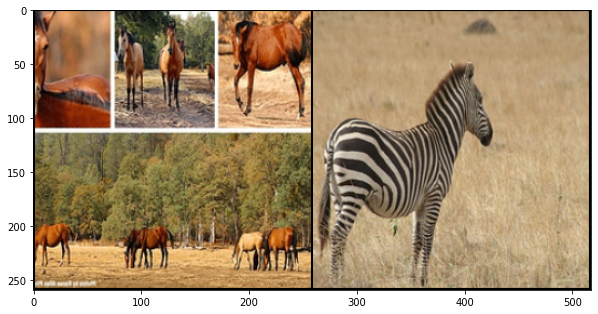

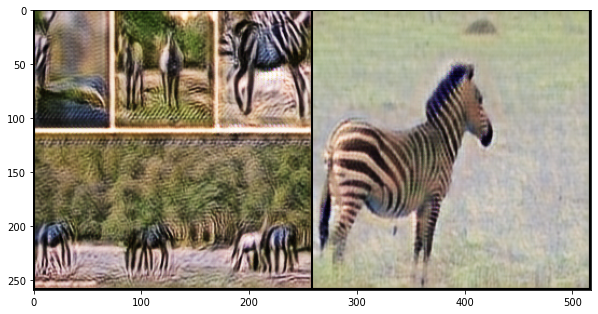

Epoch 11: Step 12000: Generator (U-Net) loss: 3.8917201956113154, Discriminator loss: 0.21295834017296625


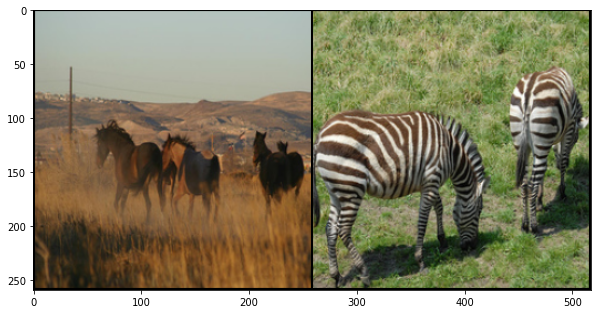

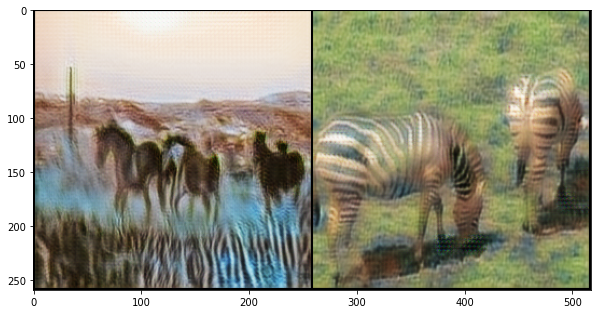

Epoch 11: Step 12300: Generator (U-Net) loss: 3.872299547195434, Discriminator loss: 0.21488104678690426


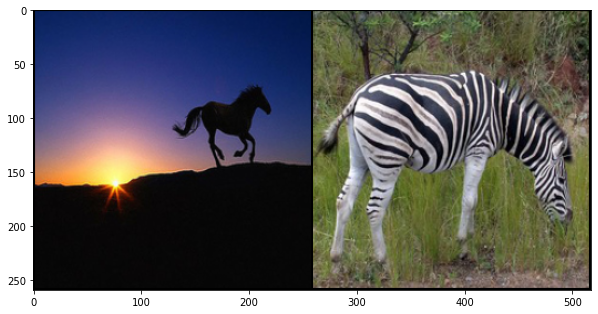

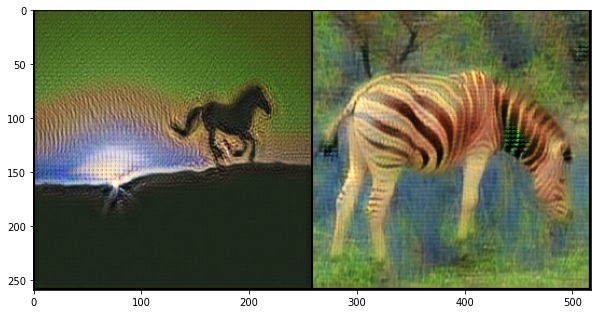

Epoch 11: Step 12600: Generator (U-Net) loss: 3.9804010097185785, Discriminator loss: 0.20264715154965723


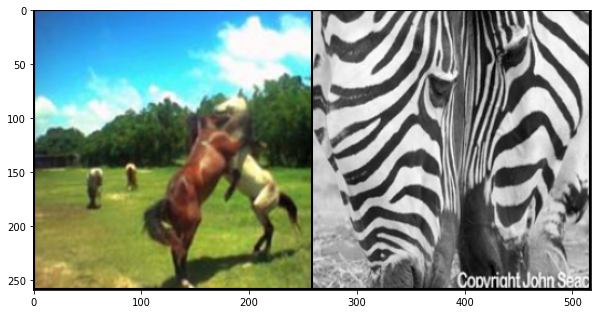

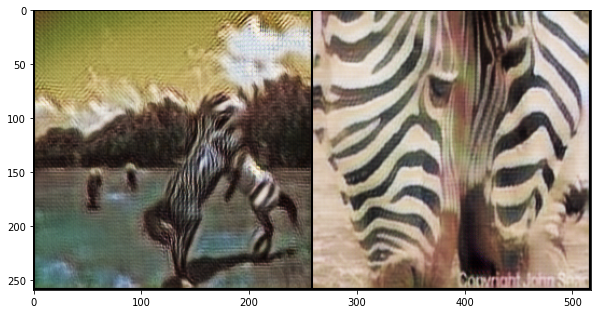

Epoch 12: Step 12900: Generator (U-Net) loss: 3.8738225769996637, Discriminator loss: 0.20820487360159573


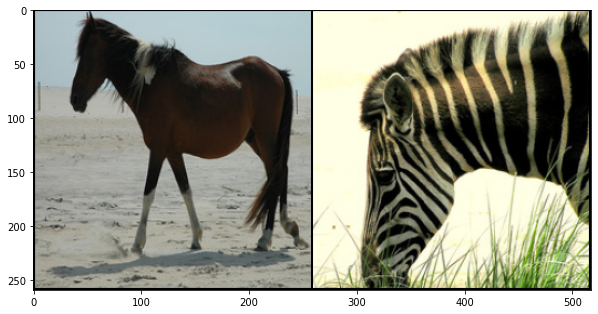

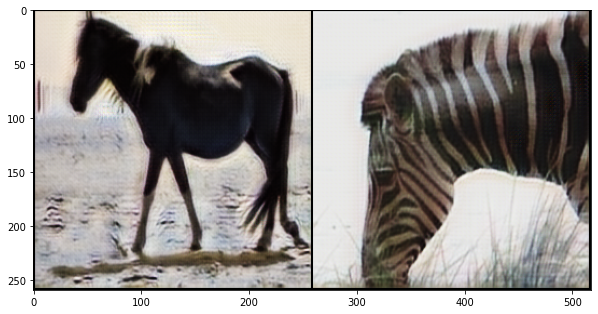

Epoch 12: Step 13200: Generator (U-Net) loss: 3.8672673567136138, Discriminator loss: 0.21080711570878835


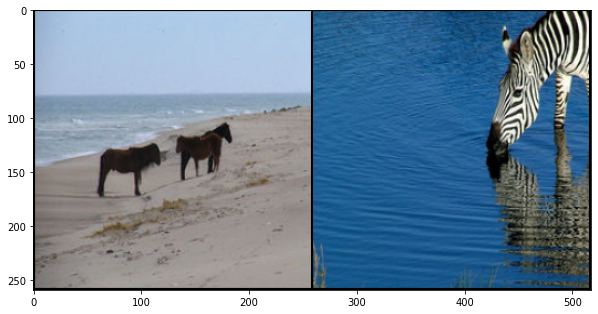

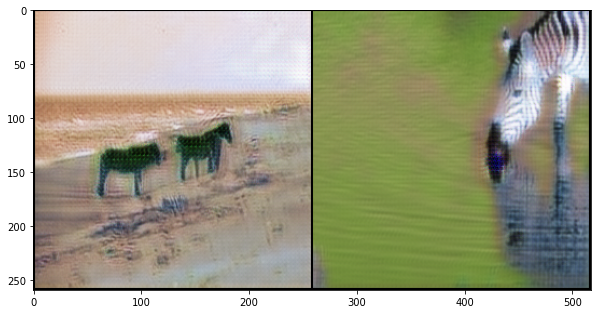

Epoch 12: Step 13500: Generator (U-Net) loss: 3.8059421269098905, Discriminator loss: 0.20798108300815007


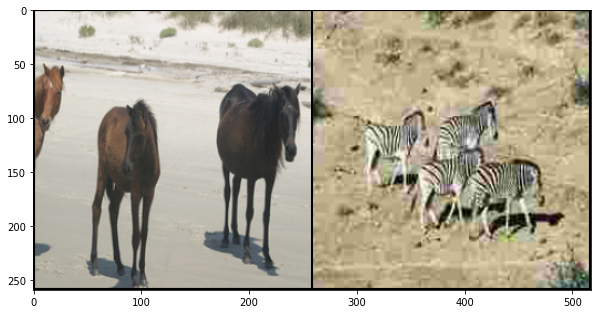

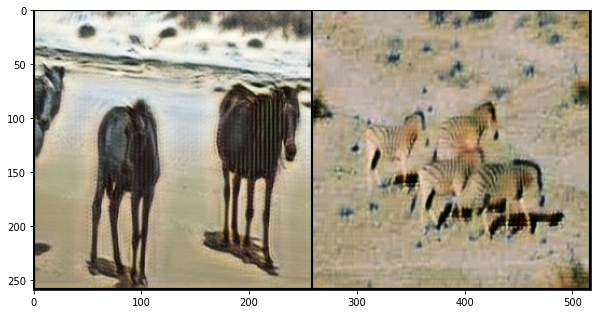

Epoch 12: Step 13800: Generator (U-Net) loss: 3.9542594250043224, Discriminator loss: 0.20443594053387634


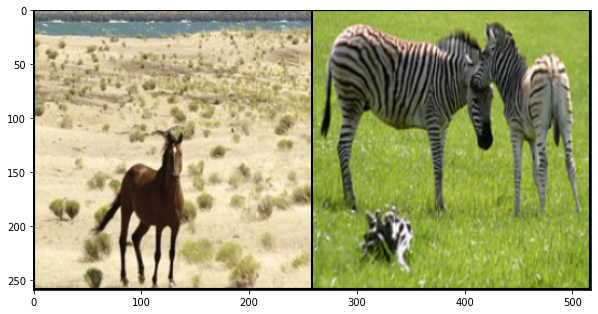

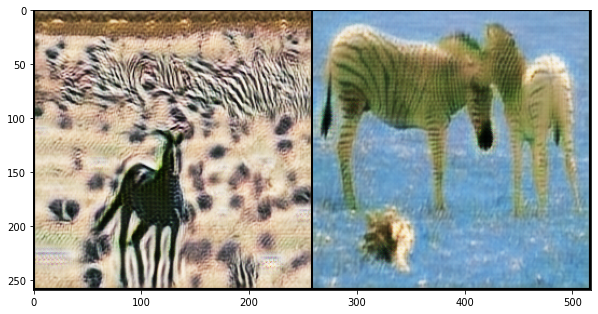

Epoch 13: Step 14100: Generator (U-Net) loss: 3.940512723128002, Discriminator loss: 0.20638800370196492


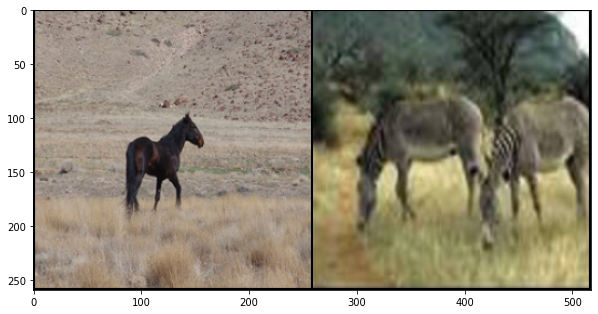

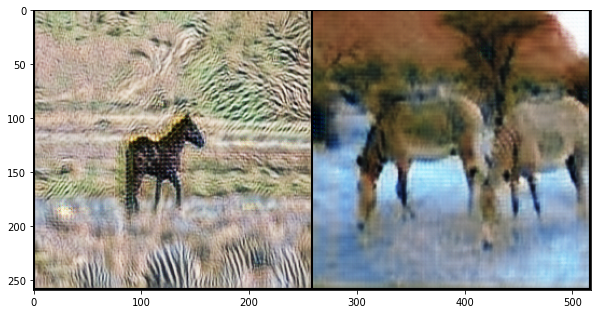

Epoch 13: Step 14400: Generator (U-Net) loss: 3.8731636635462436, Discriminator loss: 0.20821068840722237


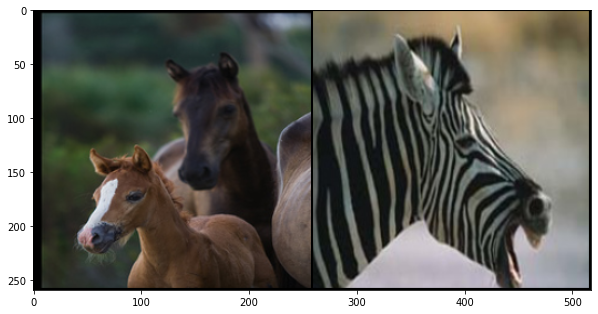

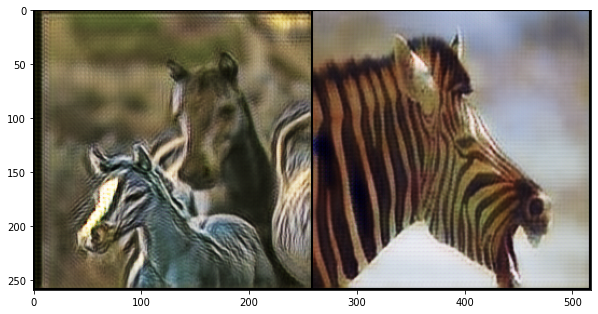

Epoch 13: Step 14700: Generator (U-Net) loss: 3.89676725625992, Discriminator loss: 0.2033851089576881


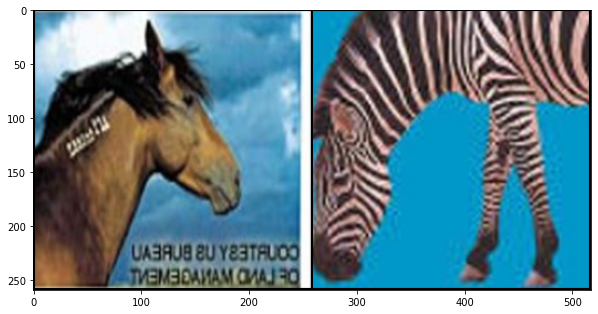

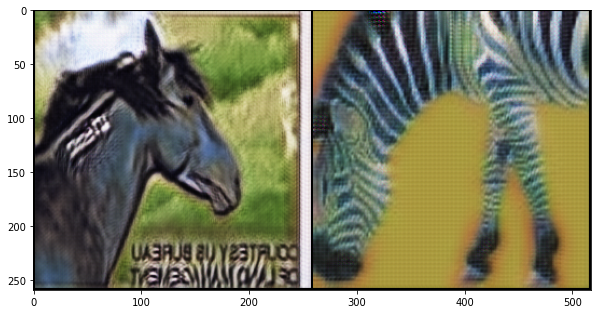

Epoch 14: Step 15000: Generator (U-Net) loss: 3.8226548790931685, Discriminator loss: 0.20917987423638504


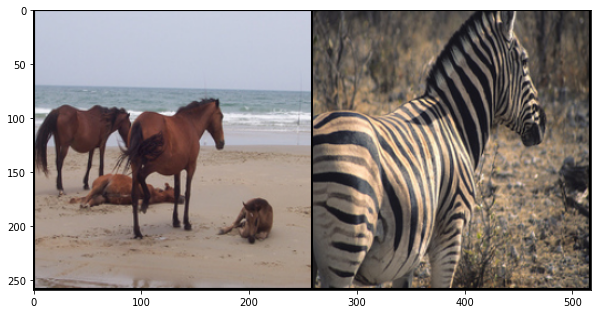

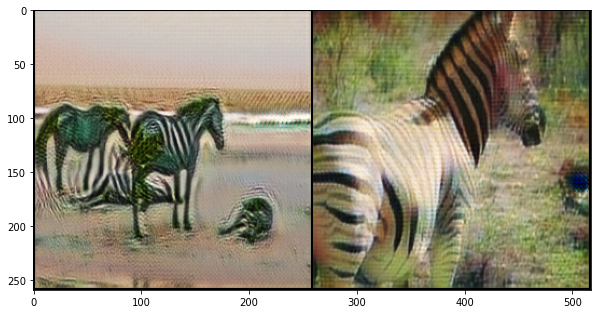

Epoch 14: Step 15300: Generator (U-Net) loss: 3.9533239499727912, Discriminator loss: 0.199201905950904


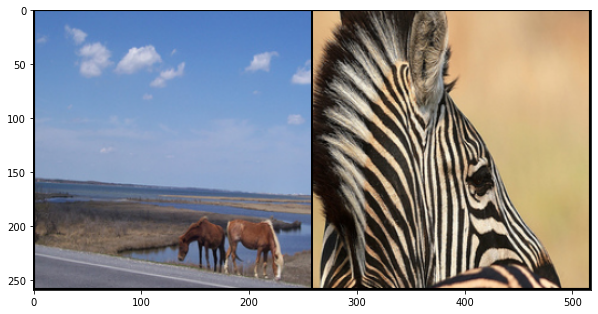

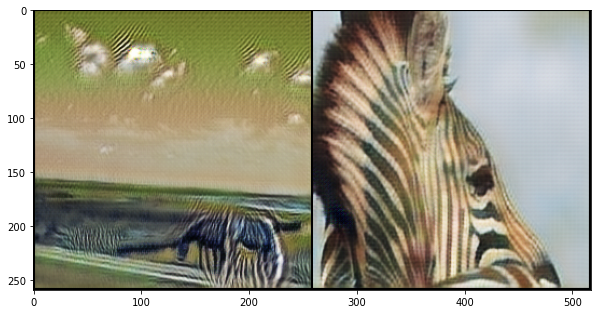

Epoch 14: Step 15600: Generator (U-Net) loss: 3.890741541385654, Discriminator loss: 0.2090694319705166


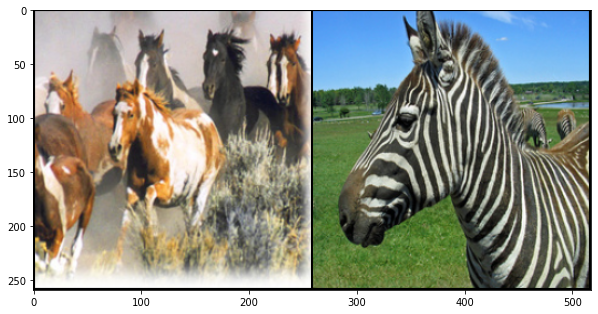

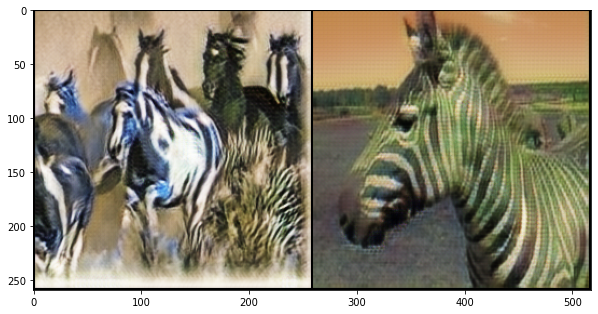

Epoch 14: Step 15900: Generator (U-Net) loss: 3.7577667037645983, Discriminator loss: 0.20654974915087215


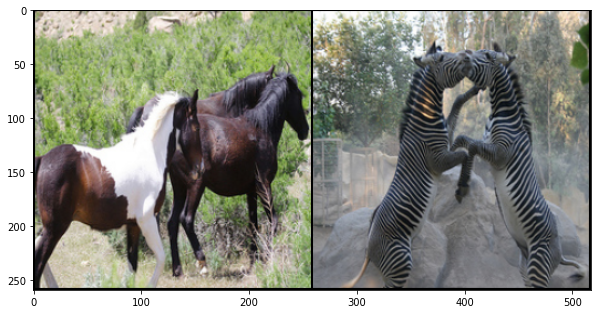

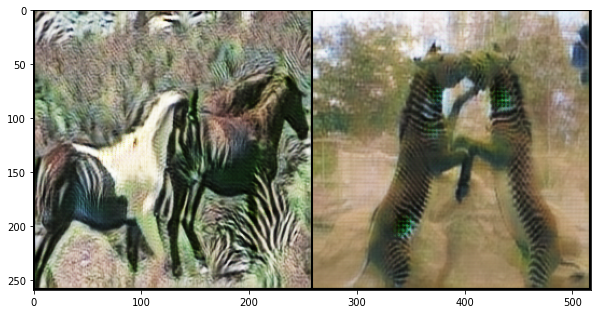

Epoch 15: Step 16200: Generator (U-Net) loss: 3.818297763665517, Discriminator loss: 0.2059815451006095


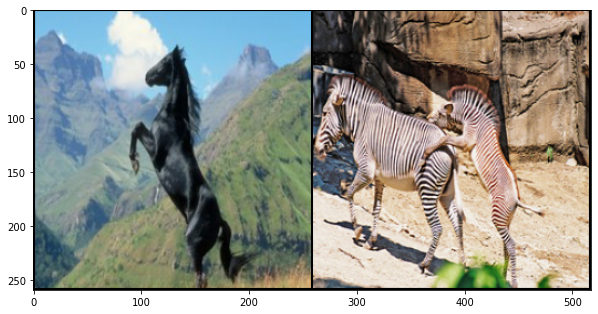

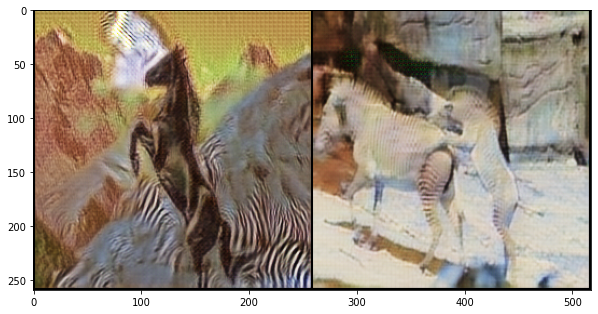

Epoch 15: Step 16500: Generator (U-Net) loss: 3.8647362263997413, Discriminator loss: 0.20465705265601478


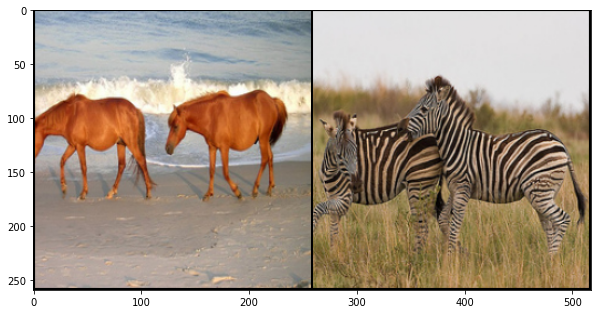

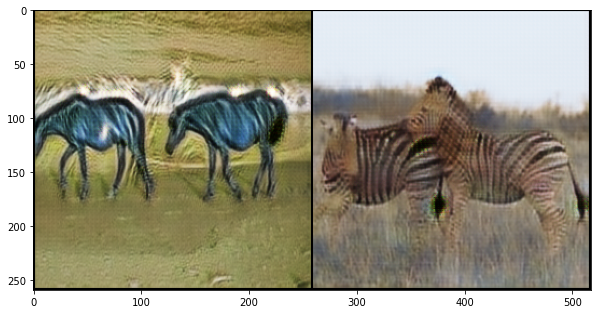

Epoch 15: Step 16800: Generator (U-Net) loss: 3.860162864526112, Discriminator loss: 0.2108400735010705


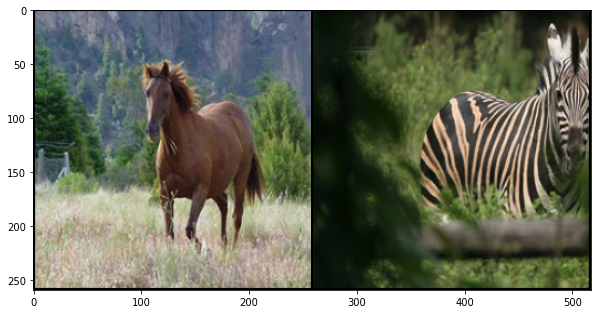

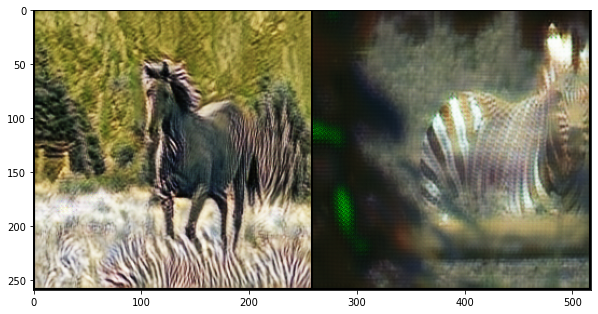

Epoch 16: Step 17100: Generator (U-Net) loss: 3.7950431180000304, Discriminator loss: 0.20008285707483692


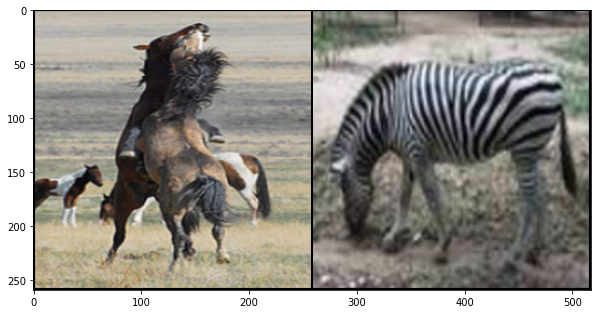

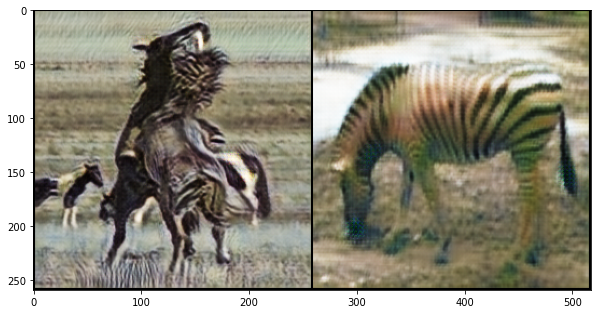

Epoch 16: Step 17400: Generator (U-Net) loss: 3.9841463057200124, Discriminator loss: 0.1978715197990337


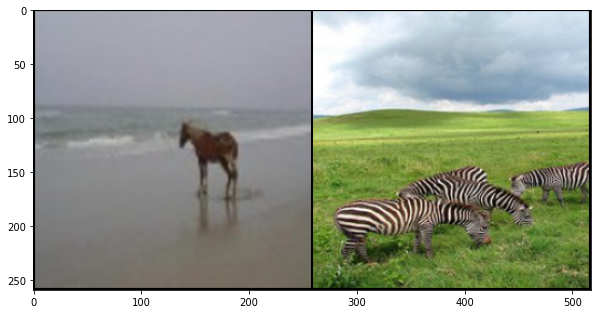

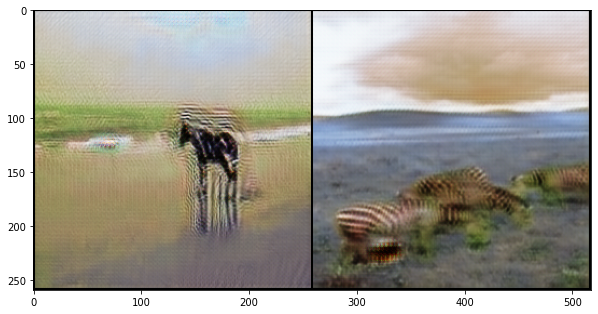

In [ ]:
from skimage import color
import numpy as np
plt.rcParams['figure.figsize'] = (10, 10)

def train(save_model=True):

    mean_discriminator_loss = 0
    mean_generator_loss = 0
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
    cur_step = 0

    for epoch in range(n_epochs):

        for real_A, real_B in tqdm(dataloader):
            
            real_A = nn.functional.interpolate(real_A, size=target_shape)
            real_B = nn.functional.interpolate(real_B, size=target_shape)

            cur_batch = len(real_A)

            real_A = real_A.to(device)
            real_B = real_B.to(device)

            # Update Discriminator A (Horse)
            disc_A_opt.zero_grad()
            fake_A = gen_BA(real_B)
            disc_A_loss = get_disc_loss(real_A, fake_A, disc_A, adv_criterion)
            disc_A_loss.backward(retain_graph=True)
            disc_A_opt.step()

            # Update Discriminator B (Zebra)
            disc_B_opt.zero_grad()
            fake_B = gen_AB(real_A)
            disc_B_loss = get_disc_loss(real_B, fake_B, disc_B, adv_criterion)
            disc_B_loss.backward(retain_graph=True)
            disc_B_opt.step()

            # Update Generator
            gen_opt.zero_grad()
            gen_loss, fake_A, fake_B = get_gen_loss(
                real_A, real_B, gen_AB, gen_BA, disc_A, disc_B, adv_criterion, recon_criterion, recon_criterion
            )
            gen_loss.backward()     # Update Gradients
            gen_opt.step()          # Updating Optimizer

            # Keeping track of average discriminator loss
            mean_discriminator_loss += disc_A_loss.item() / display_step

            # Keeping track of average generator loss
            mean_generator_loss += gen_loss.item() / display_step

            if cur_step % display_step == 0:

                print(f"Epoch {epoch}: Step {cur_step}: Generator (U-Net) loss: {mean_generator_loss}, Discriminator loss: {mean_discriminator_loss}")
                show_tensor_images(torch.cat([real_A, real_B]), size=(dim_A, target_shape, target_shape))
                show_tensor_images(torch.cat([fake_B, fake_A]), size=(dim_B, target_shape, target_shape))
                mean_generator_loss = 0
                mean_discriminator_loss = 0

                if save_model:
                    torch.save({
                        'gen_AB': gen_AB.state_dict(),
                        'gen_BA': gen_BA.state_dict(),
                        'gen_opt': gen_opt.state_dict(),
                        'disc_A': disc_A.state_dict(),
                        'disc_A_opt': disc_A_opt.state_dict(),
                        'disc_B': disc_B.state_dict(),
                        'disc_B_opt': disc_B_opt.state_dict()
                    }, f"cycleGAN_{cur_step}.pth")
            cur_step += 1


train()

In [ ]:

2 + 2